<a href="https://colab.research.google.com/github/nidhishtk/Assignment_05_Multi-Linear-Regression/blob/main/Q2_ToyotaCorolla.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Consider only the below columns and prepare a prediction model for predicting Price.

- **Price  -- Offer Price in EUROs**
- **Age_08_04 -- Age in months as in August 2004**
- **KM -- Accumulated Kilometers on odometer**
- **HP -- Horse Power**
- **cc -- Cylinder Volume in cubic centimeters**
- **Doors -- Number of doors**
- **Gears -- Number of gear positions**
- **Quarterly_Tax -- Quarterly road tax in EUROs**
- **Weight -- Weight in Kilograms**

## Attaching Resources

### Importing Necessary Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as pe
import statsmodels.formula.api as smf
import statsmodels.api as sm
from statsmodels.graphics.regressionplots import influence_plot
import warnings

warnings.filterwarnings('ignore')
plt.rcParams['figure.figsize'] = (20,15)
plt.rcParams['figure.dpi'] = 350
sns.set_style(style='darkgrid')
plt.tight_layout()

<Figure size 7000x5250 with 0 Axes>

### Adding Dataset

In [2]:
from google.colab import files
tc = files.upload()

tc = pd.read_csv('ToyotaCorolla.csv', encoding='latin1')


Saving ToyotaCorolla.csv to ToyotaCorolla.csv


In [4]:
tc

,Id,Model,Price,Age_08_04,Mfg_Month,Mfg_Year,KM,Fuel_Type,HP,Met_Color,...,Central_Lock,Powered_Windows,Power_Steering,Radio,Mistlamps,Sport_Model,Backseat_Divider,Metallic_Rim,Radio_cassette,Tow_Bar
0,1,TOYOTA Corolla 2.0 D4D HATCHB TERRA 2/3-Doors,13500,23,10,2002,46986,Diesel,90,1,...,1,1,1,0,0,0,1,0,0,0
1,2,TOYOTA Corolla 2.0 D4D HATCHB TERRA 2/3-Doors,13750,23,10,2002,72937,Diesel,90,1,...,1,0,1,0,0,0,1,0,0,0
2,3,TOYOTA Corolla 2.0 D4D HATCHB TERRA 2/3-Doors,13950,24,9,2002,41711,Diesel,90,1,...,0,0,1,0,0,0,1,0,0,0
3,4,TOYOTA Corolla 2.0 D4D HATCHB TERRA 2/3-Doors,14950,26,7,2002,48000,Diesel,90,0,...,0,0,1,0,0,0,1,0,0,0
4,5,TOYOTA Corolla 2.0 D4D HATCHB SOL 2/3-Doors,13750,30,3,2002,38500,Diesel,90,0,...,1,1,1,0,1,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1431,1438,TOYOTA Corolla 1.3 16V HATCHB G6 2/3-Doors,7500,69,12,1998,20544,Petrol,86,1,...,1,1,1,0,1,1,1,0,0,0
1432,1439,TOYOTA Corolla 1.3 16V HATCHB LINEA TERRA 2/3-...,10845,72,9,1998,19000,Petrol,86,0,...,0,0,1,0,0,1,1,0,0,0
1433,1440,TOYOTA Corolla 1.3 16V HATCHB LINEA TERRA 2/3-...,8500,71,10,1998,17016,Petrol,86,0,...,0,0,1,0,0,0,1,0,0,0
1434,1441,TOYOTA Corolla 1.3 16V HATCHB LINEA TERRA 2/3-...,7250,70,11,1998,16916,Petrol,86,1,...,0,0,0,0,0,0,1,0,0,0


In [5]:
tc = tc[['Price','Age_08_04','KM','HP','cc','Doors','Gears','Quarterly_Tax','Weight']]

tc

,Price,Age_08_04,KM,HP,cc,Doors,Gears,Quarterly_Tax,Weight
0,13500,23,46986,90,2000,3,5,210,1165
1,13750,23,72937,90,2000,3,5,210,1165
2,13950,24,41711,90,2000,3,5,210,1165
3,14950,26,48000,90,2000,3,5,210,1165
4,13750,30,38500,90,2000,3,5,210,1170
...,...,...,...,...,...,...,...,...,...
1431,7500,69,20544,86,1300,3,5,69,1025
1432,10845,72,19000,86,1300,3,5,69,1015
1433,8500,71,17016,86,1300,3,5,69,1015
1434,7250,70,16916,86,1300,3,5,69,1015


In [6]:
tc_nrow = tc.shape[0]

In [7]:
def lost_record():

    tc_nrow_now = tc.shape[0]
    lost = tc_nrow - tc_nrow_now
    lost = (lost/tc_nrow)*100
    lost = round(lost,2)

    return print('We lost ' + str(lost) + ' % data')

## Performing EDA In Dataset

### Applying Descriptive Statistics

In [8]:
tc.describe()

,Price,Age_08_04,KM,HP,cc,Doors,Gears,Quarterly_Tax,Weight
count,1436.000000,1436.000000,1436.000000,1436.000000,1436.00000,1436.000000,1436.000000,1436.000000,1436.00000
mean,10730.824513,55.947075,68533.259749,101.502089,1576.85585,4.033426,5.026462,87.122563,1072.45961
std,3626.964585,18.599988,37506.448872,14.981080,424.38677,0.952677,0.188510,41.128611,52.64112
min,4350.000000,1.000000,1.000000,69.000000,1300.00000,2.000000,3.000000,19.000000,1000.00000
25%,8450.000000,44.000000,43000.000000,90.000000,1400.00000,3.000000,5.000000,69.000000,1040.00000
50%,9900.000000,61.000000,63389.500000,110.000000,1600.00000,4.000000,5.000000,85.000000,1070.00000
75%,11950.000000,70.000000,87020.750000,110.000000,1600.00000,5.000000,5.000000,85.000000,1085.00000
max,32500.000000,80.000000,243000.000000,192.000000,16000.00000,5.000000,6.000000,283.000000,1615.00000


In [9]:
tc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1436 entries, 0 to 1435
Data columns (total 9 columns):
 #   Column         Non-Null Count  Dtype
---  ------         --------------  -----
 0   Price          1436 non-null   int64
 1   Age_08_04      1436 non-null   int64
 2   KM             1436 non-null   int64
 3   HP             1436 non-null   int64
 4   cc             1436 non-null   int64
 5   Doors          1436 non-null   int64
 6   Gears          1436 non-null   int64
 7   Quarterly_Tax  1436 non-null   int64
 8   Weight         1436 non-null   int64
dtypes: int64(9)
memory usage: 101.1 KB


In [10]:
tc.isna().sum()

Price            0
Age_08_04        0
KM               0
HP               0
cc               0
Doors            0
Gears            0
Quarterly_Tax    0
Weight           0
dtype: int64

In [11]:
def uni(df):

    for i in range(len(df.columns)):
        print('\n All Unique Value in '+ str(df.columns[i]) )
        print(np.sort(df[df.columns[i]].unique()))
        print('Total no of unique values ' + str(len(df[df.columns[i]].unique())))


In [12]:
uni(tc)


 All Unique Value in Price
[ 4350  4400  4450  4750  5150  5250  5600  5740  5750  5751  5800  5845
  5900  5950  6000  6150  6250  6400  6425  6450  6490  6495  6500  6550
  6640  6650  6750  6800  6900  6950  6990  6999  7000  7145  7150  7200
  7250  7300  7350  7400  7450  7460  7490  7495  7499  7500  7600  7750
  7795  7800  7850  7900  7950  7990  7995  7999  8000  8050  8100  8150
  8200  8250  8400  8450  8490  8495  8500  8600  8695  8700  8745  8750
  8800  8850  8895  8900  8950  8990  8995  9000  9130  9200  9245  9250
  9390  9400  9450  9475  9500  9550  9650  9695  9700  9750  9795  9799
  9800  9850  9895  9900  9930  9940  9950  9980  9990  9995 10000 10250
 10295 10350 10400 10450 10495 10500 10600 10750 10800 10845 10850 10895
 10900 10950 10990 10995 11000 11250 11290 11450 11480 11495 11500 11650
 11690 11695 11700 11710 11750 11790 11895 11900 11925 11930 11950 11990
 12000 12200 12250 12295 12400 12450 12495 12500 12695 12750 12850 12900
 12950 12995 13000 1325

In [13]:
np.sort(tc['KM'].unique())

array([     1,     15,    225, ..., 218118, 232940, 243000])

In [14]:
np.sort(tc['KM'].unique())[0]

1

- Just confirming Kilometers lowest value.

### Checking for Duplicated Values

In [15]:
tc[tc.duplicated()]

,Price,Age_08_04,KM,HP,cc,Doors,Gears,Quarterly_Tax,Weight
113,24950,8,13253,116,2000,5,5,234,1320


In [16]:
tc.drop_duplicates(inplace = True)

- There is 1 duplicate vale in are dataset

### Visualizing The Data

<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

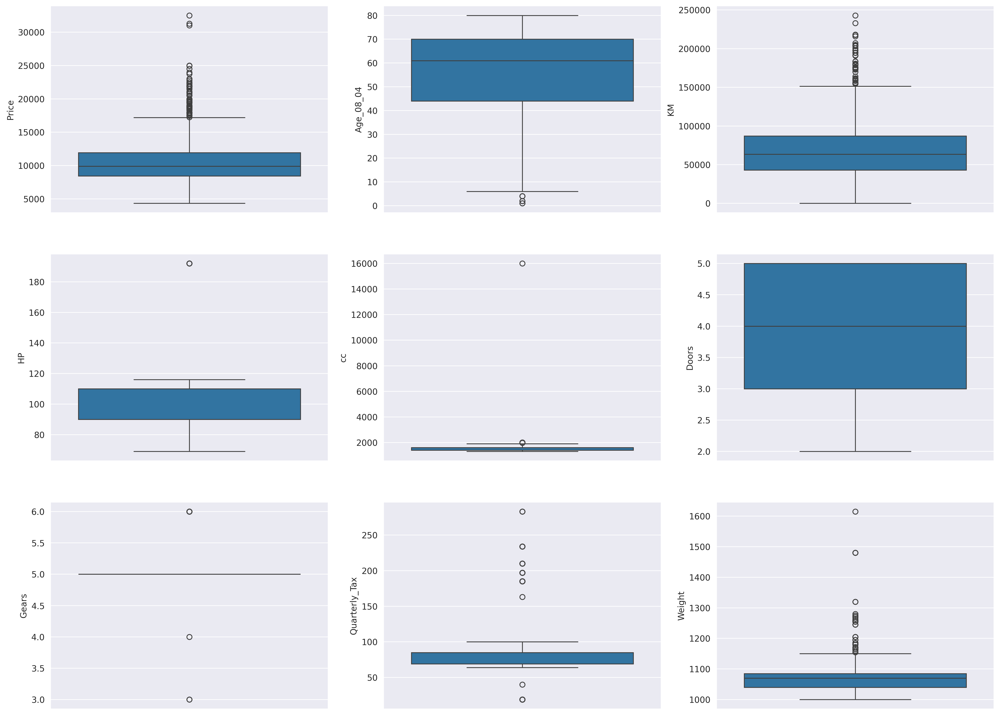

In [17]:
fig, ax = plt.subplots(3,3)

sns.boxplot(tc['Price'], ax = ax[0,0])
sns.boxplot(tc['Age_08_04'], ax = ax[0,1])
sns.boxplot(tc['KM'], ax = ax[0,2])
sns.boxplot(tc['HP'], ax = ax[1,0])
sns.boxplot(tc['cc'], ax = ax[1,1])
sns.boxplot(tc['Doors'], ax = ax[1,2])
sns.boxplot(tc['Gears'], ax = ax[2,0])
sns.boxplot(tc['Quarterly_Tax'], ax = ax[2,1])
sns.boxplot(tc['Weight'], ax = ax[2,2])

plt.tight_layout

<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

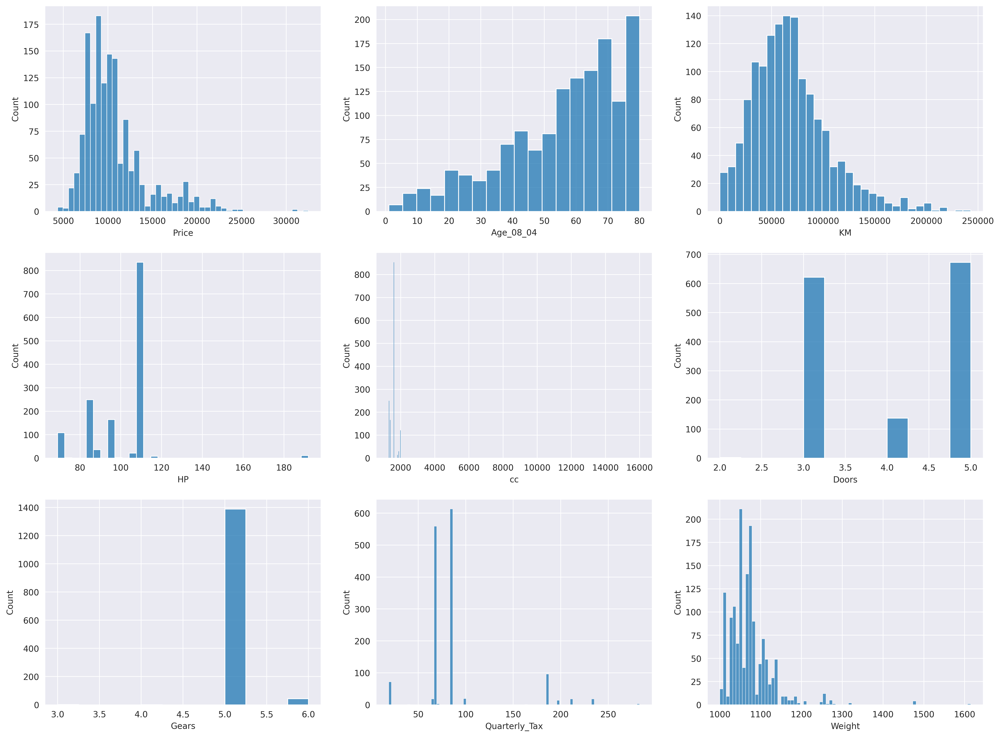

In [18]:
fig, ax = plt.subplots(3,3)

sns.histplot(tc['Price'], ax = ax[0,0])
sns.histplot(tc['Age_08_04'], ax = ax[0,1])
sns.histplot(tc['KM'], ax = ax[0,2])
sns.histplot(tc['HP'], ax = ax[1,0])
sns.histplot(tc['cc'], ax = ax[1,1])
sns.histplot(tc['Doors'], ax = ax[1,2])
sns.histplot(tc['Gears'], ax = ax[2,0])
sns.histplot(tc['Quarterly_Tax'], ax = ax[2,1])
sns.histplot(tc['Weight'], ax = ax[2,2])

plt.tight_layout

<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

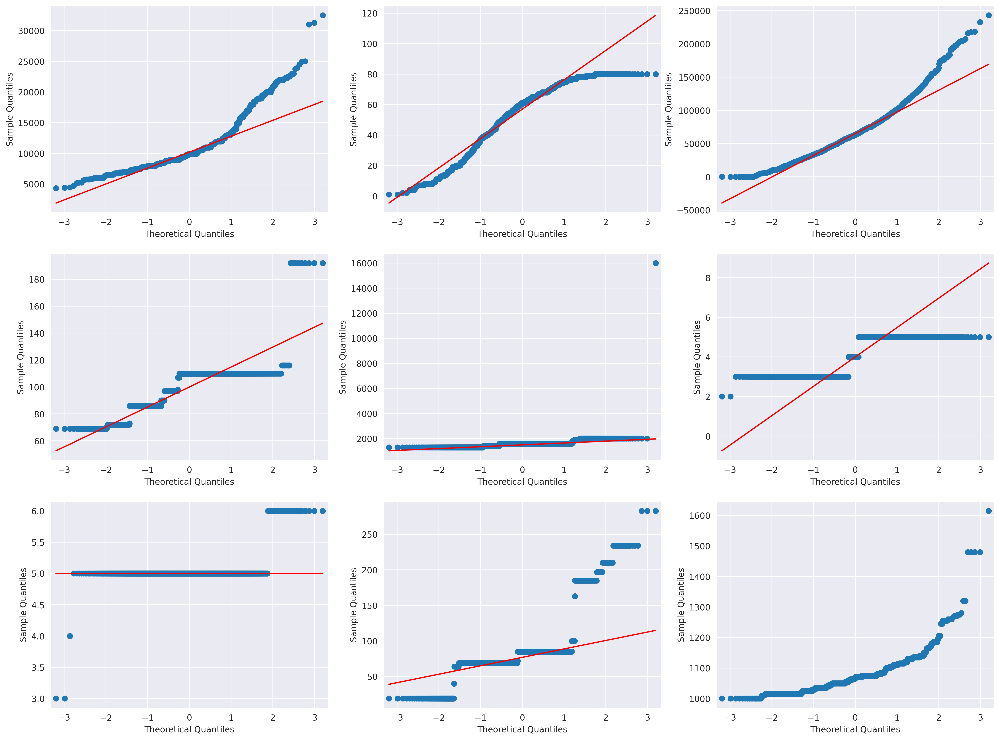

In [19]:
fig, ax = plt.subplots(3,3)

sm.qqplot(tc['Price'], ax = ax[0,0], line ='q')
sm.qqplot(tc['Age_08_04'], ax = ax[0,1], line ='q')
sm.qqplot(tc['KM'], ax = ax[0,2], line ='q')
sm.qqplot(tc['HP'], ax = ax[1,0], line ='q')
sm.qqplot(tc['cc'], ax = ax[1,1], line ='q')
sm.qqplot(tc['Doors'], ax = ax[1,2], line ='q')
sm.qqplot(tc['Gears'], ax = ax[2,0], line ='q')
sm.qqplot(tc['Quarterly_Tax'], ax = ax[2,1], line ='q')
sm.qqplot(tc['Weight'], ax = ax[2,2])

plt.tight_layout

### Correlation Analysis

In [20]:
sns.pairplot(data = tc)

<Axes: >

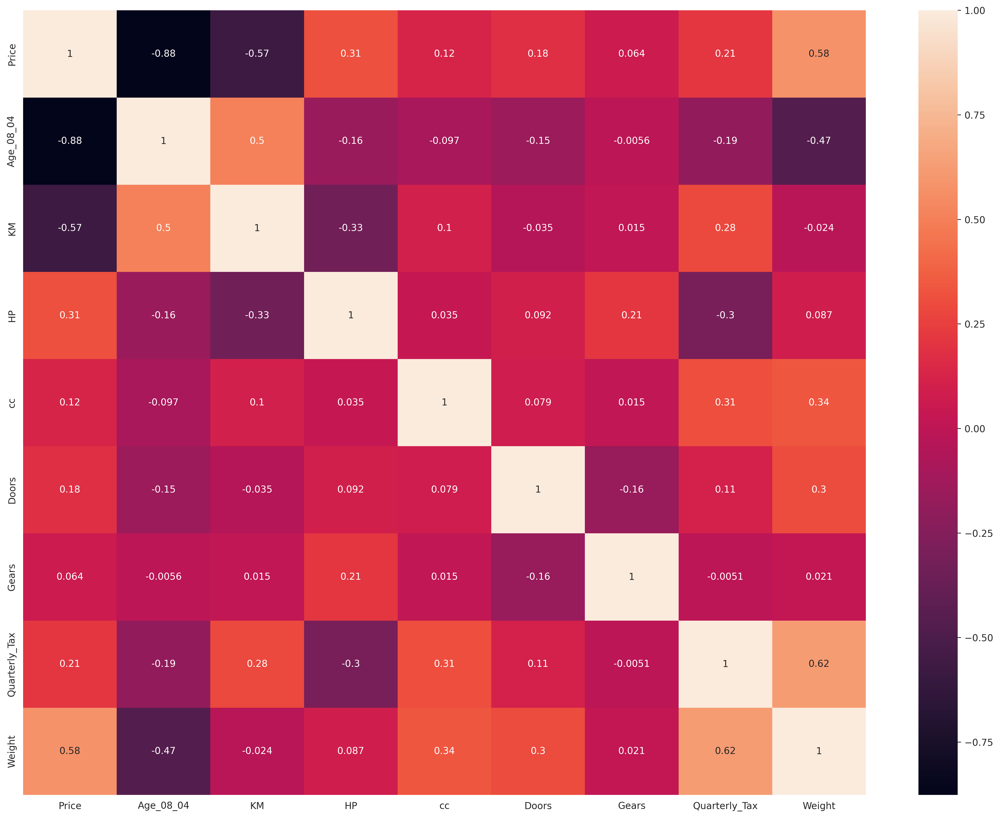

In [21]:
sns.heatmap(tc.corr(), annot = True)

### Outlier Detection

In [22]:
def outlier_percentage(df):
    for i in range(len(df.columns)):

        q1 = df[df.columns[i]].quantile(0.25)
        q3 = df[df.columns[i]].quantile(0.75)
        iqr = q3-q1

        upper = q3 + (iqr*1.5)
        lower = q1 - (iqr*1.5)

        percentage = (((len(df[df[df.columns[i]] > upper])) + (len(df[df[df.columns[i]] < lower])))/len(df[df.columns[i]]))*100

        print(str(df.columns[i]) + ' : ' + str(percentage) + ' %')




In [23]:
def replace_outlier_extream(st,col):

  q1 = st[col].quantile(0.25)
  q3 = st[col].quantile(0.75)
  iqr = q3-q1

  upper = q3 + (iqr*1.5)
  lower = q1 - (iqr*1.5)

  st[col].mask(st[col] > upper, upper, inplace=True)
  st[col].mask(st[col] < lower, lower, inplace=True)

In [24]:
def remove_outlier(st,col):
    q1 = st[col].quantile(0.25)
    q3 = st[col].quantile(0.75)
    iqr = q3-q1

    upper = q3 + (iqr*1.5)
    lower = q1 - (iqr*1.5)

    st = st[(st[col]>lower) & (st[col]<upper)]

    return st

#### Outlier Percentage (Before)

In [25]:
outlier_percentage(tc)

Price : 7.595818815331011 %
Age_08_04 : 0.4878048780487805 %
KM : 3.414634146341464 %
HP : 0.7665505226480837 %
cc : 8.501742160278745 %
Doors : 0.0 %
Gears : 3.2055749128919864 %
Quarterly_Tax : 15.540069686411151 %
Weight : 4.529616724738676 %


#### Replacing Outlier In Price Column

In [26]:
pe.box(tc['Price'], orientation='h')

In [27]:
replace_outlier_extream(tc,'Price')

In [28]:
pe.box(tc['Price'], orientation='h')

#### Removing Outlier In Age_08_04 Column

In [29]:
pe.box(tc['Age_08_04'], orientation = 'h')

In [30]:
tc = remove_outlier(tc,'Age_08_04')

In [31]:
pe.box(tc['Age_08_04'], orientation = 'h')

In [32]:
lost_record()

We lost 0.56 % data


#### Replacing Outlier In KM Column

In [33]:
pe.box(tc['KM'], orientation = 'h')

In [34]:
replace_outlier_extream(tc,'KM')

In [35]:
pe.box(tc['KM'], orientation = 'h')

#### Removing Outlier In HP Column

In [36]:
pe.box(tc['HP'], orientation = 'h')

In [37]:
tc = remove_outlier(tc,'HP')

In [38]:
pe.box(tc['HP'], orientation = 'h')

In [39]:
lost_record()

We lost 1.32 % data


#### Replacing Outlier In CC Column

In [40]:
pe.box(tc['cc'], orientation = 'h')

In [41]:
replace_outlier_extream(tc,'cc')

In [42]:
pe.box(tc['cc'], orientation = 'h')

#### Replacing Outlier In Quarterly Tax Column

In [43]:
pe.box(tc['Quarterly_Tax'], orientation = 'h')

In [44]:
replace_outlier_extream(tc,'Quarterly_Tax')

In [45]:
pe.box(tc['Quarterly_Tax'], orientation = 'h')

#### Replacing Outlier In Weight Column

In [46]:
pe.box(tc['Weight'], orientation = 'h')

In [47]:
replace_outlier_extream(tc,'Weight')

In [48]:
pe.box(tc['Weight'], orientation = 'h')

#### Outlier Percentage (After)

In [49]:
outlier_percentage(tc)

Price : 6.492589978828511 %
Age_08_04 : 0.0 %
KM : 0.0 %
HP : 0.0 %
cc : 0.0 %
Doors : 0.0 %
Gears : 2.7522935779816518 %
Quarterly_Tax : 0.0 %
Weight : 0.0 %


#### Reindexing Columns

In [50]:
tc

,Price,Age_08_04,KM,HP,cc,Doors,Gears,Quarterly_Tax,Weight
0,13500,23,46986.0,90,1900,3,5,109,1152.5
1,13750,23,72937.0,90,1900,3,5,109,1152.5
2,13950,24,41711.0,90,1900,3,5,109,1152.5
3,14950,26,48000.0,90,1900,3,5,109,1152.5
4,13750,30,38500.0,90,1900,3,5,109,1152.5
...,...,...,...,...,...,...,...,...,...
1431,7500,69,20544.0,86,1300,3,5,69,1025.0
1432,10845,72,19000.0,86,1300,3,5,69,1015.0
1433,8500,71,17016.0,86,1300,3,5,69,1015.0
1434,7250,70,16916.0,86,1300,3,5,69,1015.0


In [51]:
tc.reset_index(inplace=True)
tc.drop(columns='index',inplace=True)

tc

,Price,Age_08_04,KM,HP,cc,Doors,Gears,Quarterly_Tax,Weight
0,13500,23,46986.0,90,1900,3,5,109,1152.5
1,13750,23,72937.0,90,1900,3,5,109,1152.5
2,13950,24,41711.0,90,1900,3,5,109,1152.5
3,14950,26,48000.0,90,1900,3,5,109,1152.5
4,13750,30,38500.0,90,1900,3,5,109,1152.5
...,...,...,...,...,...,...,...,...,...
1412,7500,69,20544.0,86,1300,3,5,69,1025.0
1413,10845,72,19000.0,86,1300,3,5,69,1015.0
1414,8500,71,17016.0,86,1300,3,5,69,1015.0
1415,7250,70,16916.0,86,1300,3,5,69,1015.0


## Preparing Model From The Dataset

### Creating Model With Orignal Data

In [52]:
org_model = smf.ols('Price~Age_08_04+KM+HP+cc+Doors+Gears+Quarterly_Tax+Weight', data = tc).fit()

org_model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Price   R-squared:                       0.859
Model:                            OLS   Adj. R-squared:                  0.858
Method:                 Least Squares   F-statistic:                     1071.
Date:                Sat, 30 Mar 2024   Prob (F-statistic):               0.00
Time:                        03:23:20   Log-Likelihood:                -11919.
No. Observations:                1417   AIC:                         2.386e+04
Df Residuals:                    1408   BIC:                         2.390e+04
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept     -6280.1669   1641.237     -3.826      0.000   -9499.701   -3060.633
Age_08_04      -106.6447      2.284    -46.695      0.000    -111.125    -102.165
KM               -0.0165      0.001    -14.254      0.000      -0.019      -0.014
HP               27.0206      2.658     10.166      0.000      21.807      32.234
cc               -2.5871      0.299     -8.657      0.000      -3.173      -2.001
Doors           -81.4466     35.885     -2.270      0.023    -151.841     -11.052
Gears           446.4453    168.156      2.655      0.008     116.582     776.308
Quarterly_Tax    12.7840      2.810      4.550      0.000       7.273      18.295
Weight           20.8117      1.565     13.302      0.000      17.743      23.881
==============================================================================
Omnibus:                       51.821   Durbin-Watson:                   1.763
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              134.181
Skew:                          -0.111   Prob(JB):                     7.29e-30
Kurtosis:                       4.491   Cond. No.                     4.33e+06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 4.33e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

- By using summary function we found that model is working fine.

### Calculating VIF Value For All Column

In [53]:
def return_col(f):
    n =[]

    fl = len(f)

    for i in range(len(f)-1):
        k = str(f[i]) + '~'
        for j in range(len(f)):
            if(i != j):
                if(j < fl-1):
                    k = k + f[j]
                    k = k + '+'

                else:
                    k = k + f[j]
        n.append(k)
    for i in range(len(f)):
        l = str(f[i]) + '~'
        for j in range(len(f)):
                if(i != j):
                        if(j < fl-2):
                                l = l + f[j]
                                l = l + '+'

    l = l + f[fl-2]
    n.append(l)
    return n

In [54]:
def vif_calculation(tc,a):

    vif = []

    for j in range(len(a)):
        sam = smf.ols(return_col(a)[j],data=tc).fit().rsquared
        v = 1/(1-sam)
        vif.append(v)

    result = pd.DataFrame({
        'Model Name' : a,
        'VIF' : vif
    })
    print(result)

In [55]:
vif_calculation(tc,tc.columns[1:])

      Model Name       VIF
0      Age_08_04  2.032047
1             KM  1.894169
2             HP  1.363847
3             cc  2.981592
4          Doors  1.387523
5          Gears  1.051270
6  Quarterly_Tax  1.981613
7         Weight  3.971303


- BY calculating VIF value we confirm that the model with orignal value's are fine.

## Validating The Model

### Analyzing Residual With Help Of Q-Q Plot

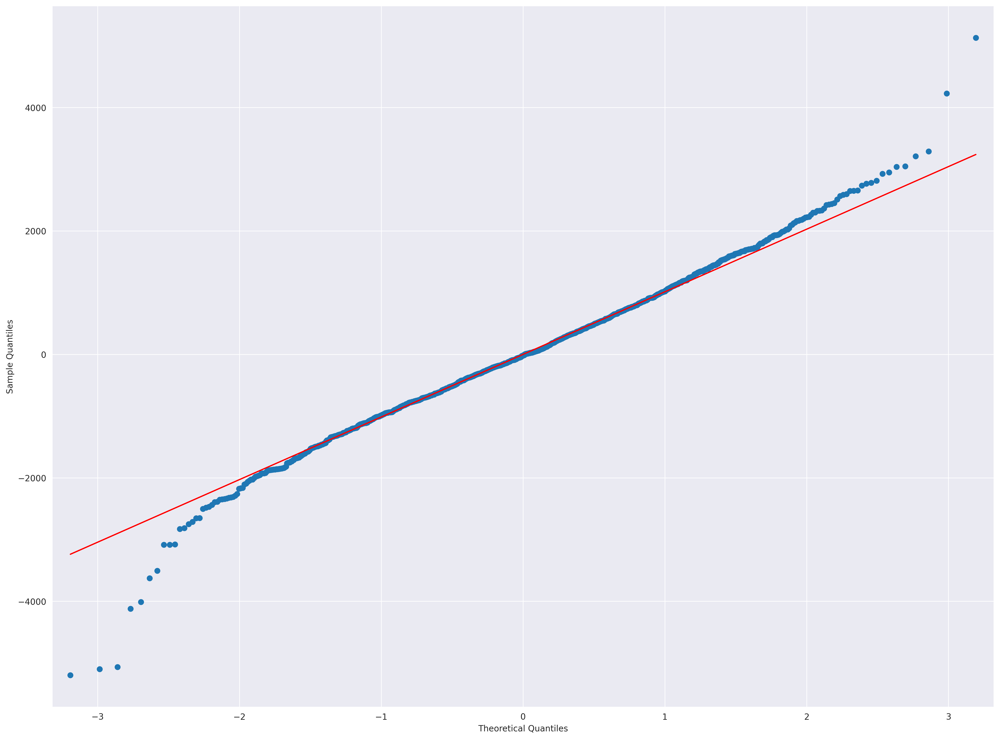

In [56]:
sm.qqplot(org_model.resid, line='q');

### Building Residual Plot

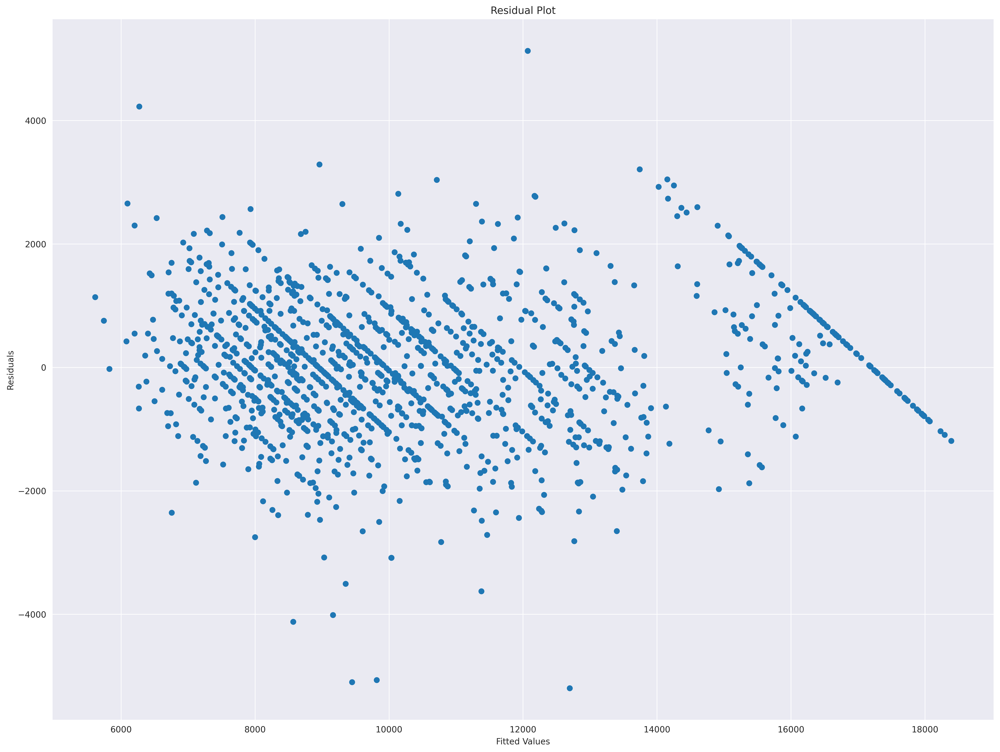

In [57]:
plt.scatter(org_model.fittedvalues,org_model.resid)
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Residual Plot')
plt.show()

### Residual VS Regressor

In [58]:
def r_vs_r(m,ncol):
    for i in range(len(ncol)):
        sm.graphics.plot_regress_exog(m,ncol[i]);
        plt.tight_layout()


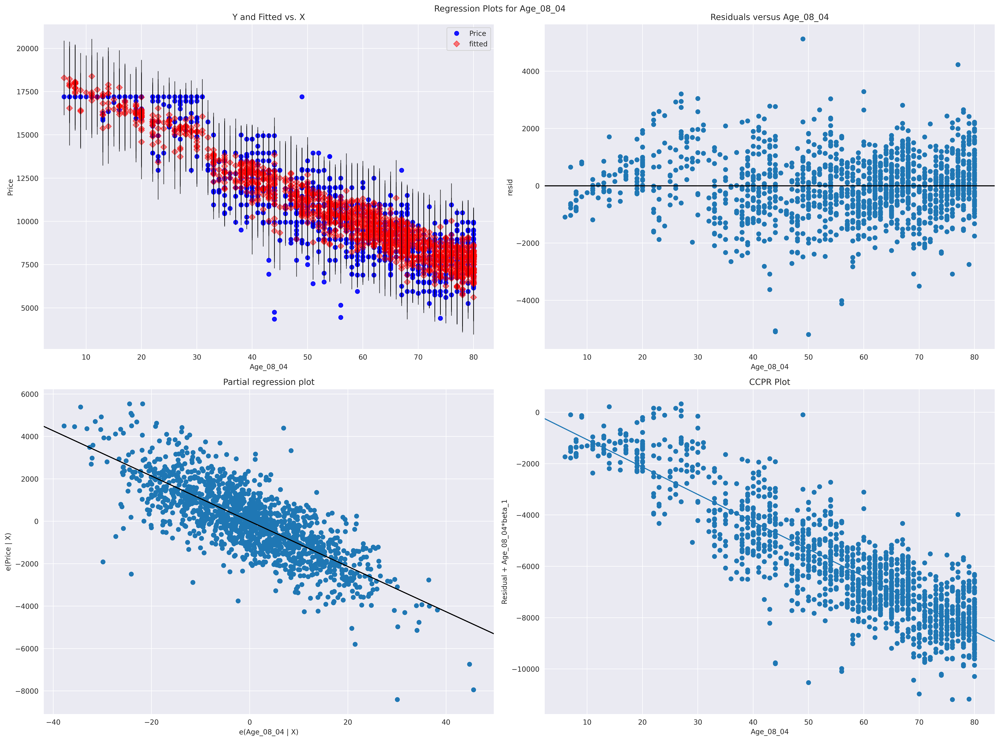

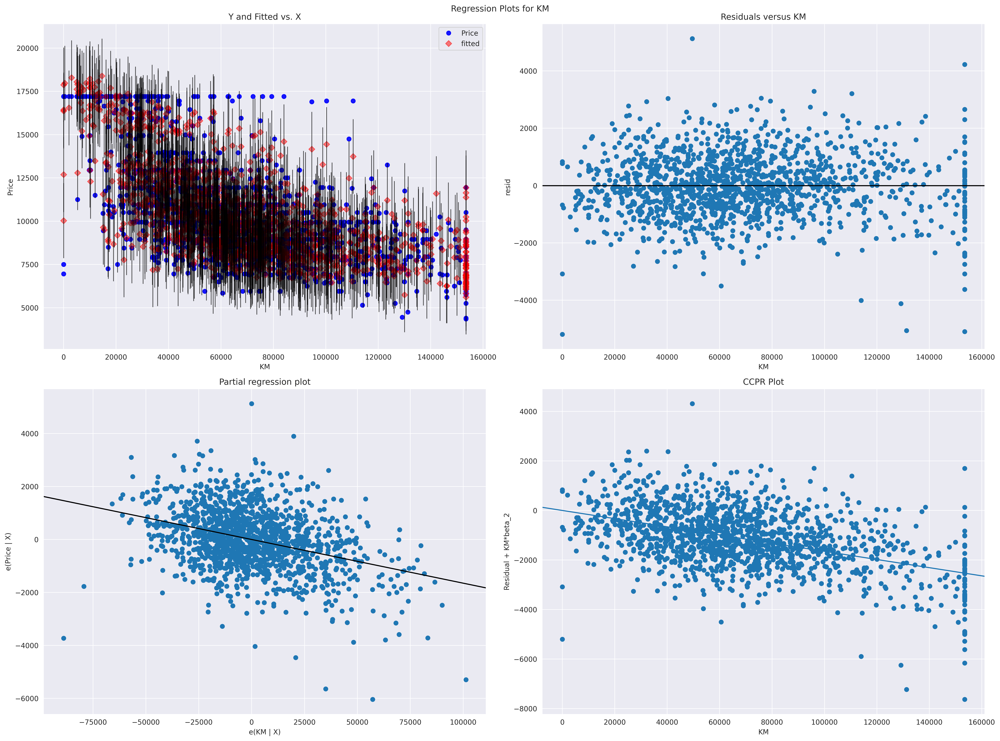

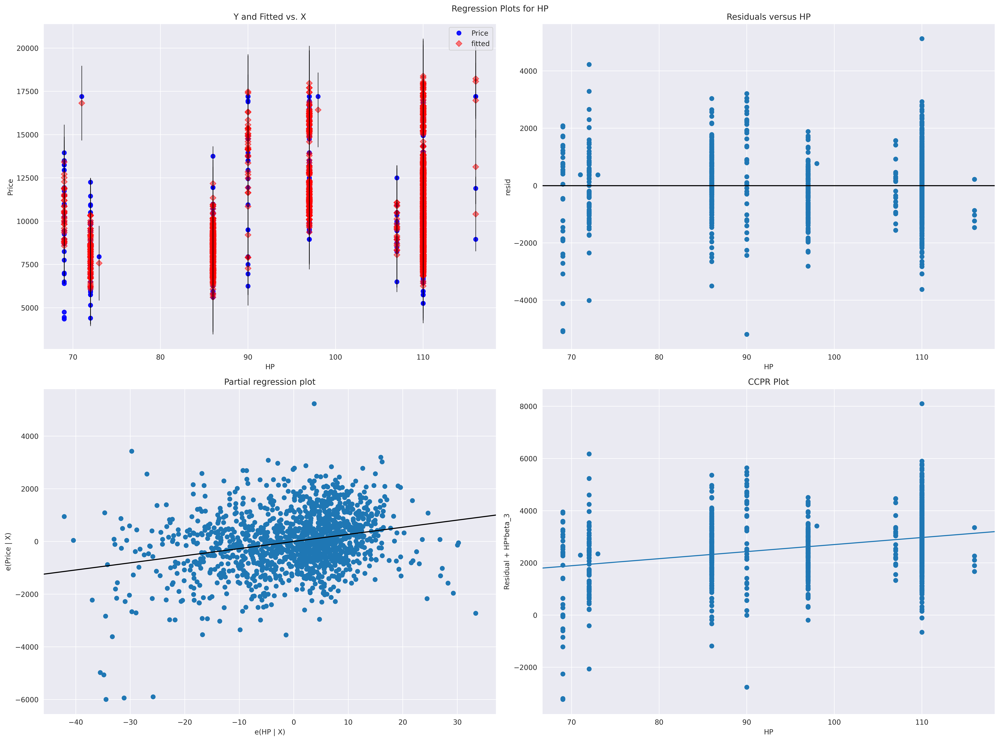

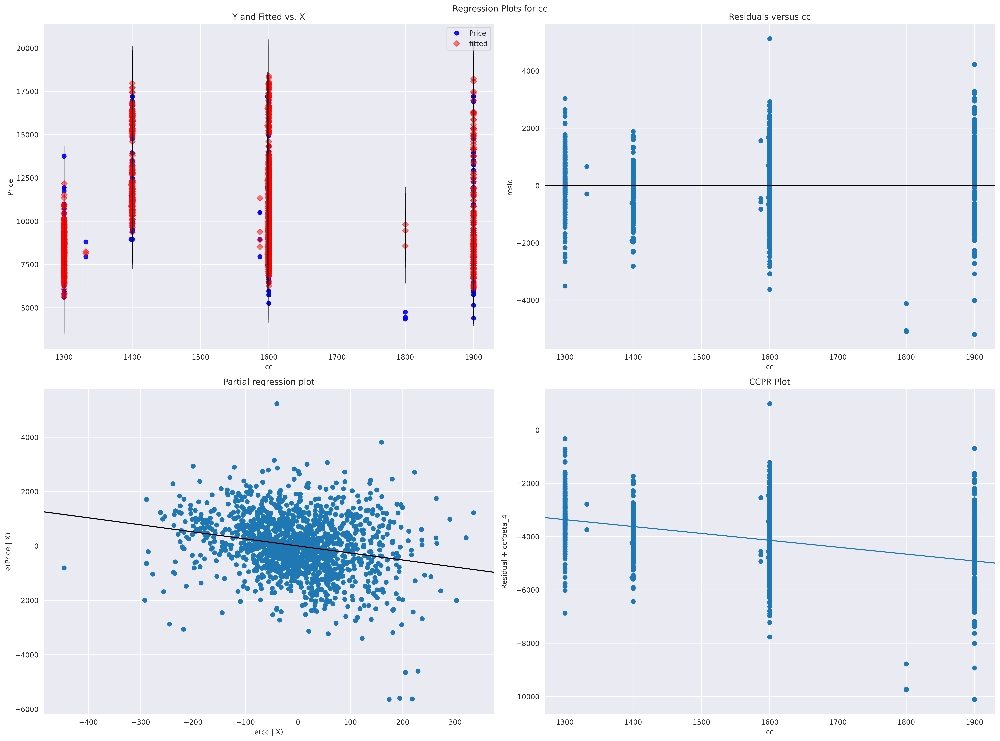

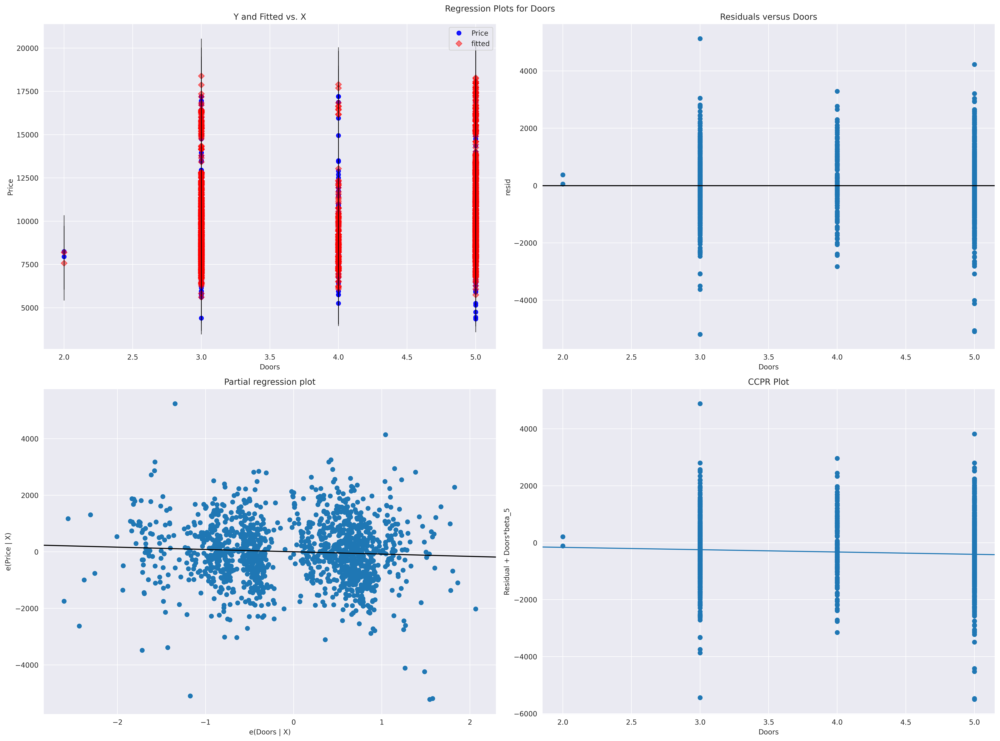

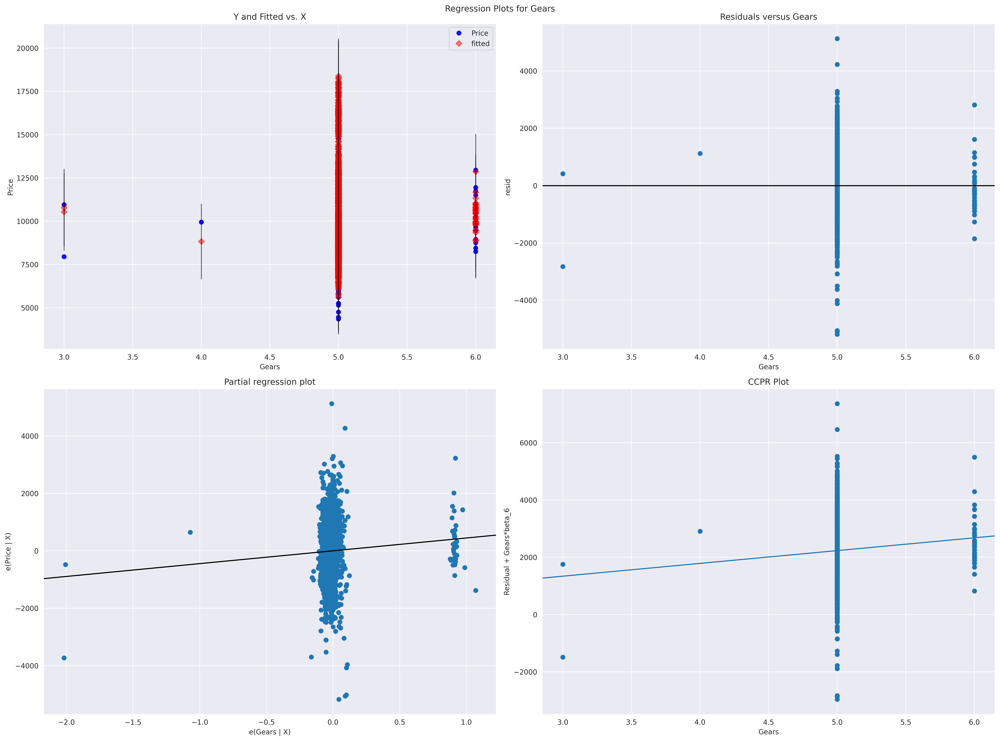

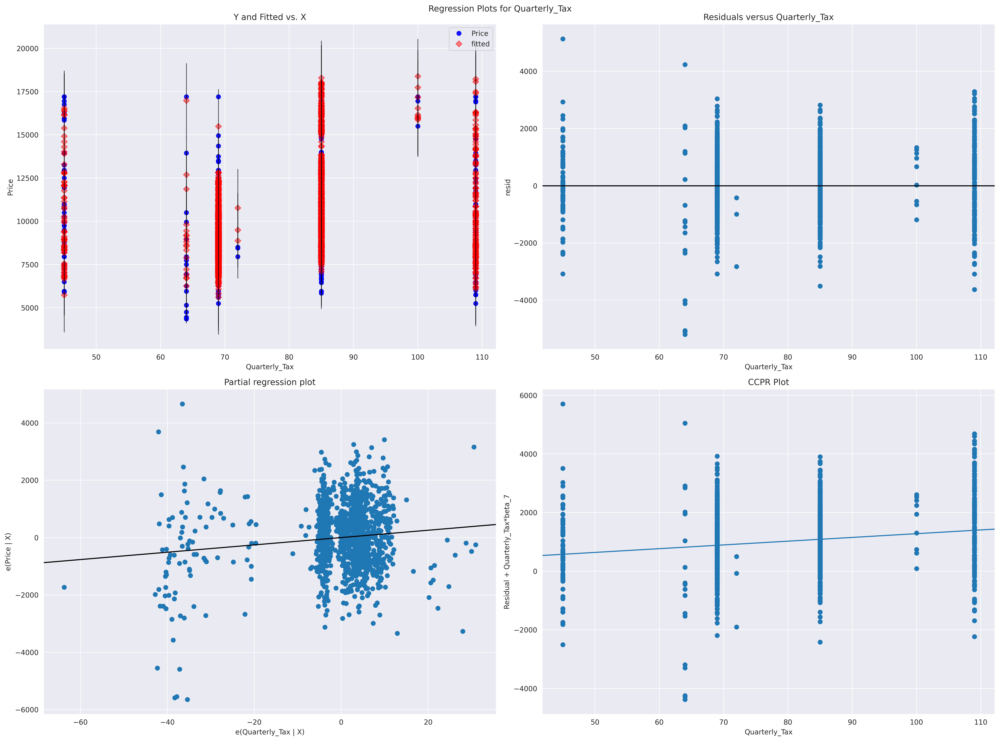

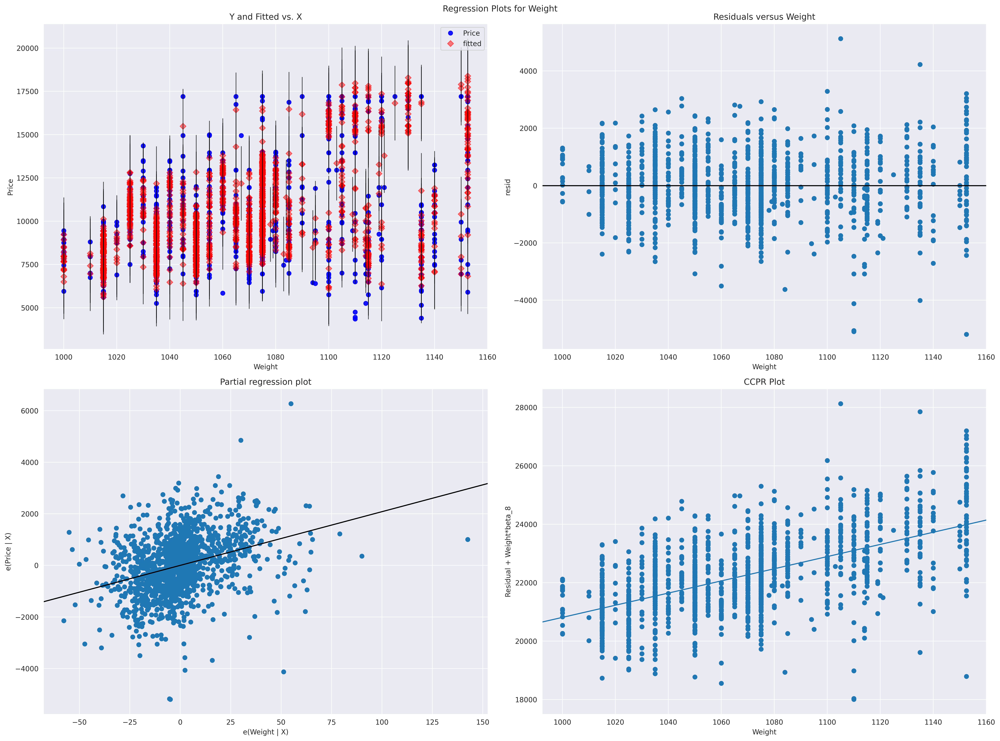

In [59]:
r_vs_r(org_model,tc.columns[1:])

## Executing Model Deletion Techniques

### Detecting Influencers Points

In [60]:
inf = org_model.get_influence()

#### Calculating Cook's Distance

In [61]:
c,p = inf.cooks_distance
c

array([3.17040056e-03, 1.23294082e-03, 1.82686801e-03, ...,
       7.37544746e-05, 1.97131433e-03, 2.34318670e-02])

#### Ploting Cooks Distance Graph

<StemContainer object of 3 artists>

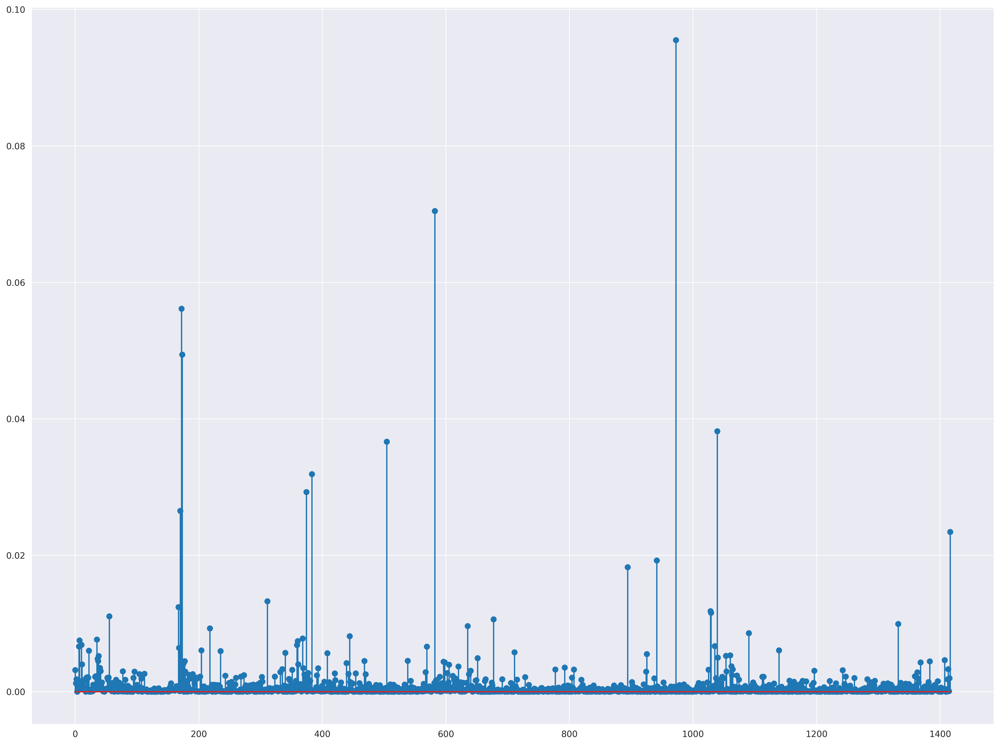

In [62]:
plt.stem(range(len(tc)),c)

In [63]:
np.argmax(c), np.max(c)

(972, 0.09550866159187034)

In [64]:
tc.iloc[[972]]

,Price,Age_08_04,KM,HP,cc,Doors,Gears,Quarterly_Tax,Weight
972,7950,58,43000.0,110,1600,4,3,72,1114.0


#### Calculating Cutoff Value

In [65]:
k = len(tc.columns)
n = len(tc)

cut_off = 3*(k+1)/n
cut_off

0.02117148906139732

#### Creating Influence Plot

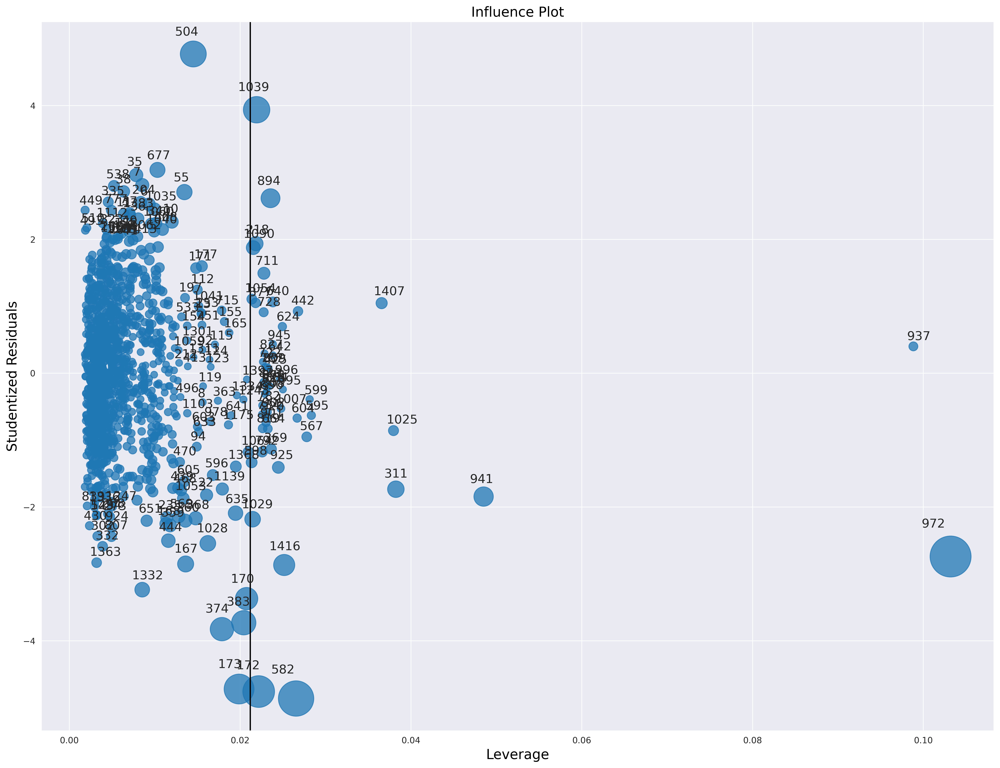

In [66]:
influence_plot(org_model)
plt.axvline(cut_off,color = 'black')

- As aren't any influencer points, so we finalize the model.

### Improving The Model

#### Remoivng Influencers Points

In [67]:
tc_demo = tc

tc_demo['cook_distance'] = c
tc_demo

,Price,Age_08_04,KM,HP,cc,Doors,Gears,Quarterly_Tax,Weight,cook_distance
0,13500,23,46986.0,90,1900,3,5,109,1152.5,0.003170
1,13750,23,72937.0,90,1900,3,5,109,1152.5,0.001233
2,13950,24,41711.0,90,1900,3,5,109,1152.5,0.001827
3,14950,26,48000.0,90,1900,3,5,109,1152.5,0.000007
4,13750,30,38500.0,90,1900,3,5,109,1152.5,0.000983
...,...,...,...,...,...,...,...,...,...,...
1412,7500,69,20544.0,86,1300,3,5,69,1025.0,0.001825
1413,10845,72,19000.0,86,1300,3,5,69,1015.0,0.003294
1414,8500,71,17016.0,86,1300,3,5,69,1015.0,0.000074
1415,7250,70,16916.0,86,1300,3,5,69,1015.0,0.001971


In [68]:
d = tc_demo.index[tc_demo['cook_distance'] > cut_off]

for i in range(len(d)):
    tc.drop(index=d[i],inplace=True)

tc

,Price,Age_08_04,KM,HP,cc,Doors,Gears,Quarterly_Tax,Weight,cook_distance
0,13500,23,46986.0,90,1900,3,5,109,1152.5,0.003170
1,13750,23,72937.0,90,1900,3,5,109,1152.5,0.001233
2,13950,24,41711.0,90,1900,3,5,109,1152.5,0.001827
3,14950,26,48000.0,90,1900,3,5,109,1152.5,0.000007
4,13750,30,38500.0,90,1900,3,5,109,1152.5,0.000983
...,...,...,...,...,...,...,...,...,...,...
1411,8450,80,23000.0,86,1300,3,5,69,1015.0,0.000381
1412,7500,69,20544.0,86,1300,3,5,69,1025.0,0.001825
1413,10845,72,19000.0,86,1300,3,5,69,1015.0,0.003294
1414,8500,71,17016.0,86,1300,3,5,69,1015.0,0.000074


In [69]:
tc.drop(columns = 'cook_distance', inplace = True)

In [70]:
tc

,Price,Age_08_04,KM,HP,cc,Doors,Gears,Quarterly_Tax,Weight
0,13500,23,46986.0,90,1900,3,5,109,1152.5
1,13750,23,72937.0,90,1900,3,5,109,1152.5
2,13950,24,41711.0,90,1900,3,5,109,1152.5
3,14950,26,48000.0,90,1900,3,5,109,1152.5
4,13750,30,38500.0,90,1900,3,5,109,1152.5
...,...,...,...,...,...,...,...,...,...
1411,8450,80,23000.0,86,1300,3,5,69,1015.0
1412,7500,69,20544.0,86,1300,3,5,69,1025.0
1413,10845,72,19000.0,86,1300,3,5,69,1015.0
1414,8500,71,17016.0,86,1300,3,5,69,1015.0


#### Reindexing Columns

In [71]:
tc

,Price,Age_08_04,KM,HP,cc,Doors,Gears,Quarterly_Tax,Weight
0,13500,23,46986.0,90,1900,3,5,109,1152.5
1,13750,23,72937.0,90,1900,3,5,109,1152.5
2,13950,24,41711.0,90,1900,3,5,109,1152.5
3,14950,26,48000.0,90,1900,3,5,109,1152.5
4,13750,30,38500.0,90,1900,3,5,109,1152.5
...,...,...,...,...,...,...,...,...,...
1411,8450,80,23000.0,86,1300,3,5,69,1015.0
1412,7500,69,20544.0,86,1300,3,5,69,1025.0
1413,10845,72,19000.0,86,1300,3,5,69,1015.0
1414,8500,71,17016.0,86,1300,3,5,69,1015.0


In [72]:
tc.reset_index(inplace=True)
tc.drop(columns='index',inplace=True)

tc

,Price,Age_08_04,KM,HP,cc,Doors,Gears,Quarterly_Tax,Weight
0,13500,23,46986.0,90,1900,3,5,109,1152.5
1,13750,23,72937.0,90,1900,3,5,109,1152.5
2,13950,24,41711.0,90,1900,3,5,109,1152.5
3,14950,26,48000.0,90,1900,3,5,109,1152.5
4,13750,30,38500.0,90,1900,3,5,109,1152.5
...,...,...,...,...,...,...,...,...,...
1402,8450,80,23000.0,86,1300,3,5,69,1015.0
1403,7500,69,20544.0,86,1300,3,5,69,1025.0
1404,10845,72,19000.0,86,1300,3,5,69,1015.0
1405,8500,71,17016.0,86,1300,3,5,69,1015.0


#### Creating Model After Removing Influencers Points

In [73]:
new_model = smf.ols('Price~Age_08_04+KM+HP+cc+Doors+Gears+Quarterly_Tax+Weight', data = tc).fit()

inf = new_model.get_influence()

##### Calculating Cook's Distance

In [74]:
c,p = inf.cooks_distance
c

array([3.87056800e-03, 1.57848918e-03, 2.28185762e-03, ...,
       3.80735653e-03, 7.55506981e-05, 2.20011748e-03])

##### Ploting Cooks Distance Graph

<StemContainer object of 3 artists>

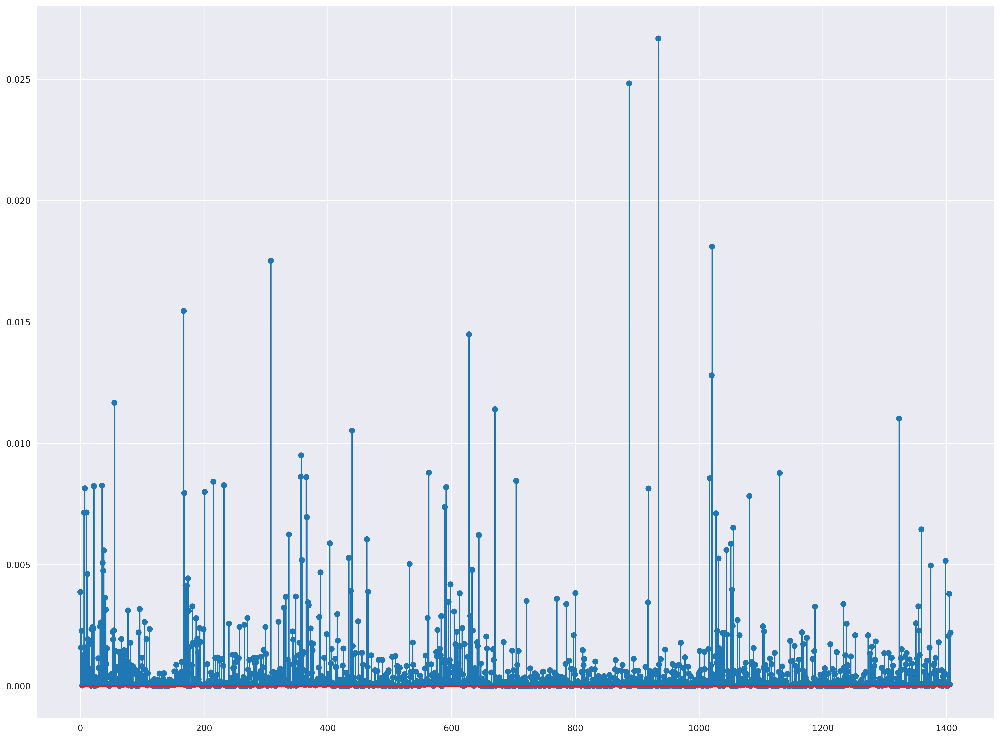

In [75]:
plt.stem(range(len(tc)),c)

In [76]:
np.argmax(c), np.max(c)

(934, 0.026680399251044182)

- Are model ready to finalize.

## Building The Final Model

In [77]:
final_model = smf.ols('Price~Age_08_04+KM+HP+cc+Doors+Gears+Quarterly_Tax+Weight', data = tc).fit()

final_model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Price   R-squared:                       0.873
Model:                            OLS   Adj. R-squared:                  0.872
Method:                 Least Squares   F-statistic:                     1199.
Date:                Sat, 30 Mar 2024   Prob (F-statistic):               0.00
Time:                        03:24:22   Log-Likelihood:                -11754.
No. Observations:                1407   AIC:                         2.353e+04
Df Residuals:                    1398   BIC:                         2.357e+04
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept     -6075.0970   1572.360     -3.864      0.000   -9159.537   -2990.657
Age_08_04      -107.2577      2.186    -49.063      0.000    -111.546    -102.969
KM               -0.0164      0.001    -14.707      0.000      -0.019      -0.014
HP               23.8087      2.576      9.242      0.000      18.755      28.862
cc               -2.3256      0.286     -8.137      0.000      -2.886      -1.765
Doors           -67.7852     34.325     -1.975      0.048    -135.120      -0.451
Gears           334.7544    167.320      2.001      0.046       6.530     662.979
Quarterly_Tax     8.6163      2.777      3.103      0.002       3.169      14.064
Weight           21.3642      1.499     14.253      0.000      18.424      24.305
==============================================================================
Omnibus:                        2.264   Durbin-Watson:                   1.778
Prob(Omnibus):                  0.322   Jarque-Bera (JB):                2.218
Skew:                           0.055   Prob(JB):                        0.330
Kurtosis:                       3.161   Cond. No.                     4.36e+06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 4.36e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

## Prediction For New Records

In [78]:
new_data = pd.DataFrame({
    'Age_08_04' : [69],
    'KM' : [41711],
    'HP' : [86],
    'cc' : [2000],
    'Doors': [5],
    'Gears' : [5],
    'Quarterly_Tax' : [210],
    'Weight' : [1170]
})

new_data

,Age_08_04,KM,HP,cc,Doors,Gears,Quarterly_Tax,Weight
0,69,41711,86,2000,5,5,210,1170


In [79]:
round(final_model.predict(new_data),2)

0    11378.68
dtype: float64